# Many-cell trajectory plotting

Designed to plot a series of time-dependent single-cell fluorescent/holographic intensities over the course of a time-lapse microscopy data set

```
Author: 
- Nathan J. Day (nathan.day.16@ucl.ac.uk)
```


### STEPS
1. Organise data
2. Select cell of interest 
3. Preview cellular measurements as pandas df
4. Raw data plots
5. Normalised data plots (work in progress)
6. Single-cell overlaid data plots (work in progress)
7. Many-cell overlaid data plots

In [118]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from scipy import ndimage
from skimage.io import imshow #used to be from skimage import io
from sklearn import preprocessing
from matplotlib import animation
from natsort import natsorted
from pathlib import Path
from skimage.external import tifffile
from btrack.dataio import HDF5FileHandler
from numpy import random
import btrack
from btrack.utils import import_HDF, import_JSON
from tqdm.notebook import tnrange, tqdm
from time import sleep

In [97]:
mean_window = 50

def colour_picker(variable_title):
        colour_list = ["GFP", "RFP", "Phase"]
        for colour in colour_list:
            if colour in variable_title:
                if colour == "GFP": 
                    return '#00A398' ## Liverpool FC 'Persian Green'
                elif colour == 'RFP':
                    return '#D00027' ## Liverpool FC 'Blood Orange'
                elif colour == 'Phase':
                    return '#FDF667' ## Liverpool FC 'Icterine'
                else:
                    return "Could not find a suitable colour to plot in, check colour_picker function"
                
def cell_colour_picker(cell): ### trying to plot each cell with a unique RGB colour value based on cell (cell ID)
        
        
        colour = [random_sample(), random_sample(), random_sample()]
        return colour
                
#this is a unity-based normalisation ie a feature scaling between [0,1]
def normalisation(series):
    max_series = np.amax(series)
    norm_factor = 1 / max_series
    scaled_series = series * norm_factor
    return scaled_series ###need to take the minimum of the series into consideration

# this is a standard score normalisation, otherwise known as z-score
def normalization(df):
    normalized_df=(df-df.mean())/df.std()
    return normalized_df

# this is the normalisation that i want, may want to come back and define df for one representative cell for all norms
def normal(df): 
    mean_window = 50 # number of periods to define rolling mean by
    smooth_df = df.rolling(window=mean_window).mean()
    norm_df = (df - smooth_df.min()) / (smooth_df.max() - smooth_df.min())
    return norm_df

# this is the normalisation that i want, may want to come back and define df for one representative cell for all norms
def normal_by_1(df): 
    cell = 72 # use this line of code here to select which cell to define all other normalisations by 
    stat_path = "/home/nathan/data/fucci/fucci1_171201/stats/cellpose_nuclear"
    fn = "cell_ID_" + str(cell) + ".csv"
    stat_location = os.path.join(stat_path, fn)
    df = pd.read_csv(stat_location)
    
    smooth_df = df.rolling(window=mean_window).mean()
    norm_df = (df - smooth_df.min()) / (smooth_df.max() - smooth_df.min())
    return norm_df

def str_convert(string): 
    li = list(string.split(", ")) 
    return li 

def which_cell(cell):
    stat_path = "/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear"
    fn = "cell_ID_" + str(cell) + ".csv"
    stat_location = os.path.join(stat_path, fn)
    df = pd.read_csv(stat_location)
    return df, cell, stat_path, fn, stat_location

### Load data

##### At time of writing this the data organisation is as follows 

``Cell_ID_(i).csv``:


| i   | Cell ID | Frame | GFP Intensity | RFP Intensity | Phase Intensity | Area | x | y | Mask filename |
|-----|---------|-------|---------------|---------------|-----------------|------|---|---|---------------|
| 0   |         |       |               |               |                 |      |   |   |               |
| 1   |         |       |               |               |                 |      |   |   |               |
| ... |         |       |               |               |                 |      |   |   |               |
| N   |         |       |               |               |                 |      |   |   |               |


##### And the directory organisation is as follows:

```
root_path/stats/mask_version/
                          Cell_ID_1.csv
                          Cell_ID_2.csv
                          ...
```
Where ```mask_version``` could be any of the following, for example
```
mask_version = { /gold
                 /modelv4
                 /modelv5
                 /cellpose_nuclear
                     ... } 
```

# Select which cell ID to plot

In [6]:
print("Input cell ID")
cell=input()
mean_window = 50

### Data location ###
root_path = '/home/nathan/data/SHARC/fucci/fucci1_171201/' # this is the dataset youre working on
mask_version = 'cellpose_nuclear' ## mask version
stat_path = os.path.join("/home/nathan/data/SHARC/fucci/fucci1_171201/stats/", mask_version)
fn = "cell_ID_" + str(cell) + ".csv"
stat_location = os.path.join(stat_path, fn)
df = pd.read_csv(stat_location)

Input cell ID
2


### Load data frame preview (optional)

In [ ]:
#df = pd.read_csv(os.path.join(stat_path, stat_location))
print(df)
print(max(df["GFP Intensity"]))

Meta-analysis of data in the form of histogram of values

In [ ]:
hist = df["GFP Intensity"].hist(bins=10)

# Raw individual-channel data plots

     Cell ID  Frame  GFP Intensity  RFP Intensity  Phase Intensity  Area    x  \
0          7      0         329049         471258         27474750  1210  750   
1          7      1         332528         477301         27206839  1225  753   
2          7      2         378134         537253         30861036  1356  748   
3          7      3         374184         489418         29481165  1390  738   
4          7      4         388559         550496         28158769  1432  730   
..       ...    ...            ...            ...              ...   ...  ...   
529        7    529        2752912         377006        109945538  3474  657   
530        7    530        2708827         382906        111715563  3483  657   
531        7    531        2378185         384527        109873755  3463  657   
532        7    532         834399         192254         46877770  1551  684   
533        7    533         458177         104658         27657221   894  686   

       y                   

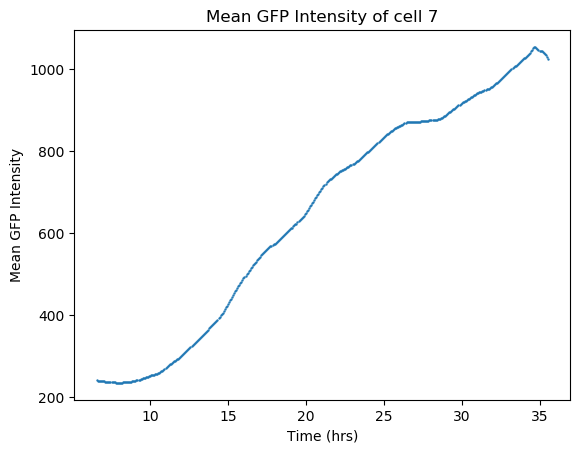

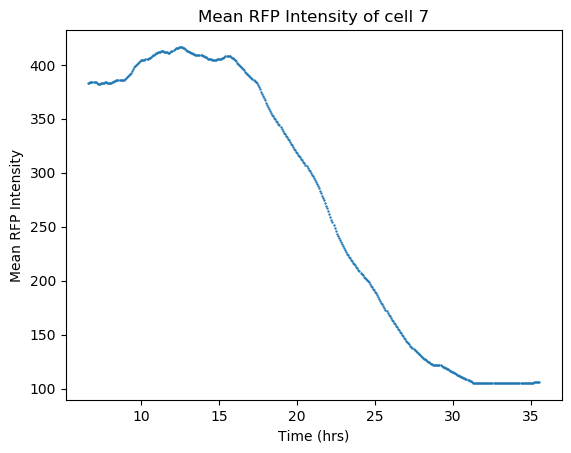

In [103]:
df = pd.read_csv(os.path.join(stat_path, stat_location))
print(df)
x = df.index
x_time = df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins

y_variables = df.columns[9:11] #this calls just the first four variables 
for y in y_variables:
    intensity = df[y] 
    rolling_mean = df[y].rolling(window=100).mean()
    plt.scatter(x_time,rolling_mean, s= 0.5)
    plt.ylabel(y)
    plt.xlabel('Time (hrs)')
    title = y + ' of cell ' + cell
    plt.title(title)
    plt.show()

# Normalised individual-channel data plots

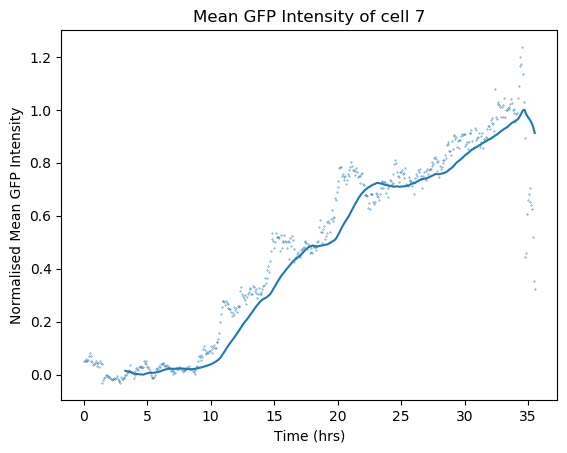

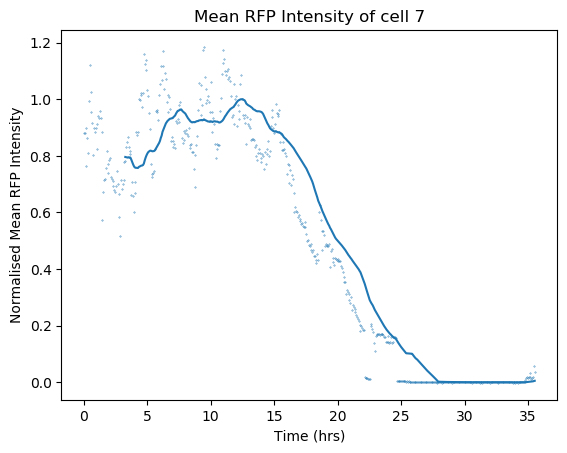

In [119]:
df = pd.read_csv(os.path.join(stat_path, stat_location))
x = df.index
x_time = df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins

y_variables = df.columns[9:11] #this calls just the first four variables 
for y in y_variables:
    ### Pick method of normalisation ###
    norm_intensity = normal(df[y])
    
    rolling_mean = norm_intensity.rolling(window=mean_window).mean()
    plt.scatter(x_time,[norm_intensity], s= 0.1)
    plt.plot(x_time,rolling_mean)# s= 0.1)
    #plt.plot(x_time,[norm_intensity], s= 0.1)
    ylabel = "Normalised " + y
    plt.ylabel(ylabel)
    plt.xlabel('Time (hrs)')
    title = y + ' of cell ' + str(cell)
    plt.title(title)
    plt.show()

# Normalised single-cell multi-channel data plots

Input cell ID
2


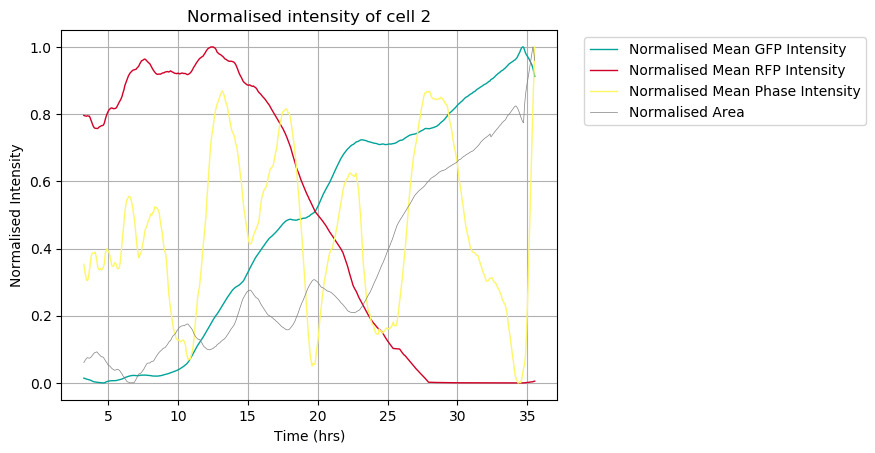

<Figure size 60000x24000 with 0 Axes>

In [238]:
### cell selector
print("Input cell ID")
cell=input()
which_cell(cell) #come back to this!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

# stat_path = "/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear"
# fn = "cell_ID_" + str(cell) + ".csv"
# stat_location = os.path.join(stat_path, fn)
# df = pd.read_csv(stat_location)
norm_df = pd.DataFrame([])

x = df.index
x_time = df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins
y_variables = list(df.columns[2:6]) + list(df.columns[9:12]) #this calls just the first four variables 

## collect different variables to normalise
for y in y_variables:
        y_name = 'Normalised ' + y
        norm_intensity = normal(df[y]) 
        norm_df[y_name] = norm_intensity  
## plot different norm variables
#print(norm_df)
for column in norm_df.columns[4:7]: #index in df.columns indicate variables to plot
    colour = colour_picker(column)
    rolling_mean = norm_df[column].rolling(window=mean_window).mean()
    plt.plot(x_time, rolling_mean, linewidth=1, color=colour, label = column)
    #plt.plot(x_time, norm_df[column], linewidth=0.5, color=colour, label = column)
plt.plot(x_time, norm_df["Normalised Area"].rolling(window=mean_window).mean(), linewidth=0.5, color="gray", label = "Normalised Area" )
plt.ylabel("Normalised Intensity")
plt.xlabel('Time (hrs)')
plt.legend()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid()
title = "Normalised intensity of cell " + str(cell)
#title = norm_df.columns[0]+", "+ norm_df.columns[1]+ ", "+ norm_df.columns[2]+" of cell " + cell
plt.title(title)
plt.figure(figsize=[20,8], dpi=3000)
save_title = title + ".png"
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)
plt.show()

# Overlaid many-cell NORMALISED incorrectly? plots, alignment needed _WORK IN PROGRESS_


Input cell IDs
817
2


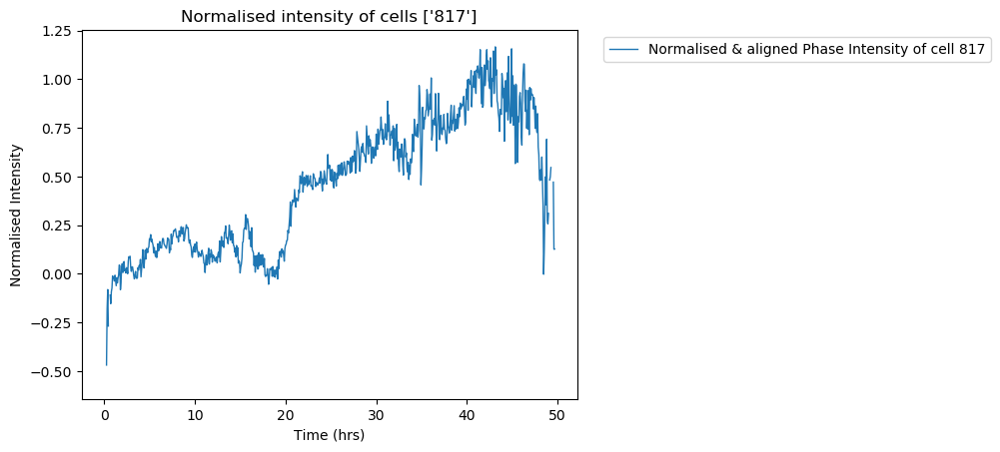

In [483]:

norm_aligned_df = pd.DataFrame([])
#cell_ids = [72, 57, 16, 46, 182, 239]#,414, 441, 570, 640, 659, 713, 727, 748]

print("Input cell IDs")
cell_ids = str_convert(input())
for cell in cell_ids:
    #cell = 46
    ### Load data
    fn = "cell_ID_" + str(cell) + ".csv"
    stat_location = os.path.join(stat_path, fn)
    df = pd.read_csv(stat_location)
   
    # creating a new column to use in different cells traj. alignment 
    df['Summed Fluoresence Intensity'] = df['GFP Intensity'] + df['RFP Intensity'] 
    #alignment point t0 is the min of total fluorescence ie when the fucci signal goes dark post-mitosis
    t0 = df['Summed Fluoresence Intensity'].idxmin()
    print(t0)
    #new aligned_df where t0 is at index 0
    aligned_df = df.shift(periods = -t0) #this line of code brings the minimum point to beginning of the df, but discards the preceeding data... fix this by shifting it not to index0 but forwards??  
    x = aligned_df.index
    x_time = aligned_df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins
    
    #normalisation of aligned_df
    y_variables = aligned_df.columns[2:6] #this calls just four variables, gfp, rfp, phase and cell area
    for y in y_variables:
            y_name = 'Normalised & aligned ' + y
            ### pick method of normalisation ### 
            norm_intensity = normal(aligned_df[y]) 
            #norm_intensity = normalization(aligned_df[y]) 
            norm_aligned_df[y_name] = norm_intensity 
    
    #plotting normalised intensities on same plot
    for column in norm_aligned_df.columns[2:3]: #index in df.columns indicate variables to plot, input a variable selection option
        colour = colour_picker(column)
        label = column + " of cell " + str(cell)
        #this conditional statement trims the x variable to be the same length as the y var if it is longer (only a zero index issue really as max length x_var will be 1 more than y_var)
        if len(x_time) > len(norm_aligned_df[column]):
            x_time = x_time[:len(norm_aligned_df[column])]
        #print(len(x_time), len(norm_aligned_df[column]), column, ", cell ", cell, ", t0 is ", t0) #troubleshooter
        plt.plot(x_time, norm_aligned_df[column][:len(x_time)], linewidth=1, label = label)#, color=colour)
        #rolling_mean = norm_aligned_df[column][:len(x_time)].rolling(window=40).mean()
        #plt.plot(x_time, rolling_mean, linewidth=1, label = label)#, color=colour)
        #plt.plot(x_time, norm_df["Normalised Area"], linewidth=0.5, color="gray", label = "Normalised Area" )
        
plt.ylabel("Normalised Intensity")
plt.xlabel('Time (hrs)')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
title = "Normalised intensity of cells " + str(cell_ids)
plt.title(title)
save_title = title + ".png"
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)
plt.show()



# Meta-analysis of tracks

Iteratively load all track dataframes in root_path

In [79]:
stat_path = "/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear"
cell_track_fns = natsorted([m for m in os.listdir(stat_path) if m.endswith('.csv')])
df_list = []
for cell_track_fn in cell_track_fns:
    stat_location = os.path.join(stat_path, cell_track_fn)
    df_name = cell_track_fn.replace('.csv','_df')
    df_list.append(df_name)
    exec('{} = pd.read_csv(stat_location)'.format(df_name))    

print(cell_track_fns)


['cell_ID_1.csv', 'cell_ID_2.csv', 'cell_ID_3.csv', 'cell_ID_4.csv', 'cell_ID_5.csv', 'cell_ID_6.csv', 'cell_ID_7.csv', 'cell_ID_8.csv', 'cell_ID_9.csv', 'cell_ID_10.csv', 'cell_ID_11.csv', 'cell_ID_12.csv', 'cell_ID_13.csv', 'cell_ID_15.csv', 'cell_ID_16.csv', 'cell_ID_17.csv', 'cell_ID_18.csv', 'cell_ID_19.csv', 'cell_ID_20.csv', 'cell_ID_21.csv', 'cell_ID_22.csv', 'cell_ID_23.csv', 'cell_ID_25.csv', 'cell_ID_26.csv', 'cell_ID_27.csv', 'cell_ID_28.csv', 'cell_ID_30.csv', 'cell_ID_31.csv', 'cell_ID_32.csv', 'cell_ID_33.csv', 'cell_ID_34.csv', 'cell_ID_35.csv', 'cell_ID_36.csv', 'cell_ID_37.csv', 'cell_ID_38.csv', 'cell_ID_39.csv', 'cell_ID_41.csv', 'cell_ID_42.csv', 'cell_ID_43.csv', 'cell_ID_44.csv', 'cell_ID_45.csv', 'cell_ID_46.csv', 'cell_ID_47.csv', 'cell_ID_48.csv', 'cell_ID_49.csv', 'cell_ID_50.csv', 'cell_ID_51.csv', 'cell_ID_52.csv', 'cell_ID_53.csv', 'cell_ID_54.csv', 'cell_ID_55.csv', 'cell_ID_56.csv', 'cell_ID_57.csv', 'cell_ID_58.csv', 'cell_ID_59.csv', 'cell_ID_60.csv', 

AttributeError: 'list' object has no attribute 'replace'

List track lengths and plot histogram

In [438]:
for cell_track_fn in cell_track_fns:
    stat_location = os.path.join(stat_path, cell_track_fn)  
    if (len(pd.read_csv(stat_location))) > 700:
            print(cell_track_fn.replace('.csv',' exists for'), len(pd.read_csv(stat_location)), "frames")

cell_ID_5 exists for 756 frames
cell_ID_16 exists for 803 frames
cell_ID_20 exists for 719 frames
cell_ID_28 exists for 1095 frames
cell_ID_43 exists for 811 frames
cell_ID_46 exists for 1092 frames
cell_ID_57 exists for 865 frames
cell_ID_72 exists for 1091 frames
cell_ID_164 exists for 762 frames
cell_ID_182 exists for 1062 frames
cell_ID_239 exists for 1030 frames
cell_ID_260 exists for 714 frames
cell_ID_330 exists for 711 frames
cell_ID_414 exists for 857 frames
cell_ID_441 exists for 938 frames
cell_ID_503 exists for 756 frames
cell_ID_570 exists for 879 frames
cell_ID_640 exists for 846 frames
cell_ID_659 exists for 838 frames
cell_ID_713 exists for 815 frames
cell_ID_727 exists for 810 frames
cell_ID_748 exists for 804 frames
cell_ID_817 exists for 748 frames
cell_ID_1100 exists for 811 frames
cell_ID_1352 exists for 1872 frames
cell_ID_1646 exists for 1872 frames


In [ ]:
track_lengths = []
for cell_track_fn in cell_track_fns:
    stat_location = os.path.join(stat_path, cell_track_fn) 
    track_lengths.append(len(pd.read_csv(stat_location)))


tracks_df = pd.Series(track_lengths)
#print(max(tracks_df))

tracks_df.plot.hist(grid=True, bins=25, rwidth=0.9,
                   color='#607c8e')
title = 'Distribution of track lengths cellpose'
plt.title(title)
plt.xlabel('Track length')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)

# FUCCI-time x-variable creation RAW

Input cell IDs
57
t = S-phase looks to be 17 frames
t = S-phase v2 looks to be 118 frames
t = S-phase v3 looks to be 852 frames
t = Mitosis looks to be 857 frames


/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44:

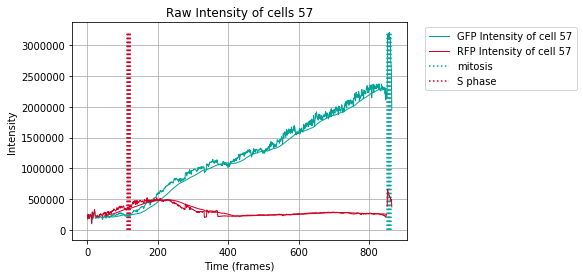

In [15]:
mean_window = 50 # number of periods to define rolling mean by


#print(df)
print("Input cell IDs")
cell =input() 

fn = "cell_ID_" + str(cell) + ".csv"
stat_location = os.path.join(stat_path, fn)
df = pd.read_csv(stat_location)

# creating a new column to use in different cells traj. alignment 
df['Sum FI'] = df['GFP Intensity'] + df['RFP Intensity'] #summed fluoresence intensity
df['delta FI'] = df['GFP Intensity'] - df['RFP Intensity'] #difference between fluoresence intensity
df['GFP:RFP ratio'] = df['GFP Intensity'] / df['RFP Intensity'] #ratio between fluoresence intensity

### defining the onset of S phase (tS) as when the difference between green and red channels is minimum ###
tS2 = (abs(df['delta FI']).idxmin())
print("t = S-phase looks to be", tS2, "frames")
### defining the onset of S phase when the ratio of GFP:RFP is closest to 1
tS = ((abs(df['GFP:RFP ratio'])-1).idxmin())
print("t = S-phase v2 looks to be", tS, "frames")
### defining the onset of S phase when the ratio of GFP:RFP is closest to 1 but also the GFP+RFP value is max ### UNFINISHED, necessary?
tS3 = ((abs(df['GFP:RFP ratio'])-1).idxmin() + df['Sum FI']).idxmax()
print("t = S-phase v3 looks to be", tS3, "frames")

### defining the approx onset of M phase as when the difference between green and red channels is max ###
tM = df['delta FI'].idxmax()
print("t = Mitosis looks to be", tM, "frames")

### OR defining the approx onset of M phase as when the green is max using rolling mean ### !!!!!!!!!!!!!!!!!!!
#tM = df['GFP Intensity'].rolling(window=40).idxmax()
#print("t = Mitosis looks to be", tM, "frames")

### storing marker points in the fucci time column... plot this column somehow?
df["FUCCI phase"] = "Uncertain" # first populate column with uncertainty
for idx in df.index:
    if df['delta FI'][idx] < 0:
        df['FUCCI phase'][idx] = "G1"
    if df['delta FI'][idx] > 0:
        df['FUCCI phase'][idx] = "S/G2/M"
    if df['Area'][idx] < 1000: # this condition deems phase estimation uncertain if mask is small
        df['FUCCI phase'][idx] = "Uncertain"
df["FUCCI phase"][tS-1:tS+2] = "G1 to S phase transition"
df["FUCCI phase"][tM-1:tM+2] = "Mitosis to G1 phase transition"

### creation of FUCCI time column for alignment, t0 = 0, tS = 1, tM = 2
df["FUCCI time"] = 0
df["FUCCI time"][tS:tS+1] = 0.5
df["FUCCI time"][tM:tM+1] = 1

x = df["Frame"]
x_time = df["Frame"] * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins

columns = ["GFP Intensity", "RFP Intensity"]#, "Sum FI", "delta FI"]
#plotting normalised intensities on same plot
for column in columns: #index in df.columns indicate variables to plot, input a variable selection option
    colour = colour_picker(column)
    label = column + " of cell " + str(cell)
    #this conditional statement trims the x variable to be the same length as the y var if it is longer (only a zero index issue really as max length x_var will be 1 more than y_var)
    #print(len(x_time), len(aligned_df[column]), column, ", cell ", cell, ", t0 is ", t0) #troubleshooter
    plt.plot(x, df[column], linewidth=1, color=colour)#, label = label)#, color=colour)
    rolling_mean = df[column].rolling(window=mean_window).mean()
    #plt.plot(x_time, rolling_mean, linewidth=1, label = label, color=colour)
    plt.plot(x, rolling_mean,  label = label, color=colour, linewidth=1)
    #plt.plot(x_time, df["Normalised Area"], linewidth=0.5, color="gray", label = "Normalised Area" )
plt.grid(which = "both")        
plt.ylabel("Intensity")
plt.xlabel('Time (frames)')
title = "Raw Intensity of cells " + str(cell)

plt.title(title)
save_title = title + ".png"
### phase checkpoints
x_tM = tM+mean_window/2 
x_tS = tS+mean_window/2
x_error_range = 6
x_tM = [int("{}".format(tM+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
x_tS = [int("{}".format(tS+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
plt.vlines(x_tM, 0, df["GFP Intensity"].max(), label = "mitosis", colors = '#00A398', linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.vlines(x_tS, 0, df["GFP Intensity"].max(), label = "S phase", colors = "#D00027", linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
#plt.style.use('default')
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)

plt.show()

## this is for testing the FUCCI phase column
#df.to_csv("/home/nathan/data/SHARC/fucci/fucci1_171201/stats/test.csv", index = False)

# FUCCI-time x-variable creation NORMAL

Input cell IDs
7
['GFP Intensity', 'RFP Intensity', 'Phase Intensity', 'Area', 'Mean GFP Intensity', 'Mean RFP Intensity', 'Mean Phase Intensity']
t = S-phase looks to be 295 frames
t = Mitosis looks to be 515 frames


/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:58:

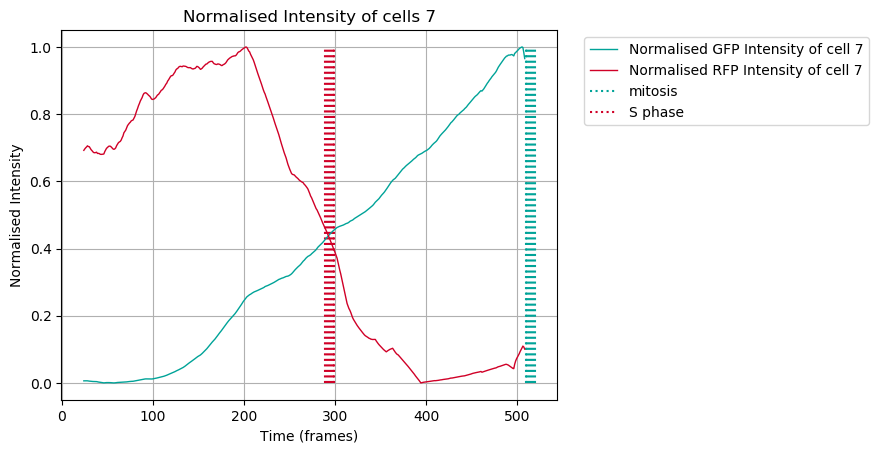

t = S-phase looks to be 270 frames
t = Mitosis looks to be 518 frames


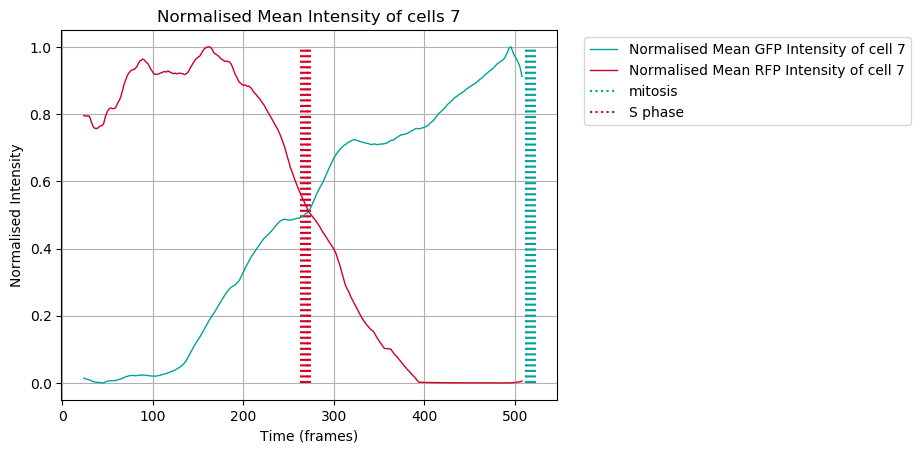

In [198]:
##### mean_window = 50 # number of periods to define rolling mean by


print("Input cell IDs")
cell =input() 

fn = "cell_ID_" + str(cell) + ".csv"
stat_location = os.path.join(stat_path, fn)
df = pd.read_csv(stat_location)

## collect different intensities to normalise ##
y_variables = list(df.columns[2:6]) +list(df.columns[9:12])#this calls just the first four variables 
norm_df = pd.DataFrame([])
for y in y_variables:
        #intensity = norm_df[y] 
        y_name = 'Normalised ' + y      
        ### pick method of normalisation 
        #norm_intensity = normalisation(norm_df[y]) 
        #norm_intensity = normalization(norm_df[y]) 
        norm_intensity = normal(df[y]) 
        norm_df[y_name] = norm_intensity
#print(df)
#print(norm_df)

# creating a new column to use in different cells traj. alignment 
norm_df['Sum FI'] = norm_df['Normalised GFP Intensity'] + norm_df['Normalised RFP Intensity'] #summed fluoresence intensity
norm_df['delta FI'] = norm_df['Normalised GFP Intensity'] - norm_df['Normalised RFP Intensity'] #difference between fluoresence intensity
norm_df['GFP:RFP ratio'] = norm_df['Normalised GFP Intensity'] / norm_df['Normalised RFP Intensity'] #ratio between fluoresence intensity

### defining the onset of S phase (tS) as when the difference between green and red channels is minimum ###
tS = (abs(norm_df['delta FI']).idxmin())
print("t = S-phase looks to be", tS, "frames")
# ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1
# tS2 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin())
# print("t = S-phase v2 looks to be", tS2, "frames")
# ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1 but also the GFP+RFP value is max ### UNFINISHED, necessary?
# tS3 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin() + norm_df['Sum FI']).idxmax()
# print("t = S-phase v3 looks to be", tS3, "frames")

### defining the approx onset of M phase as when the difference between green and red channels is max ###
tM = norm_df['delta FI'].idxmax()
print("t = Mitosis looks to be", tM, "frames")

### OR defining the approx onset of M phase as when the green is max using rolling mean ### !!!!!!!!!!!!!!!!!!!
#tM = norm_df['GFP Intensity'].rolling(window=40).idxmax()
#print("t = Mitosis looks to be", tM, "frames")

### storing marker points in the fucci time column... plot this column somehow?
norm_df["FUCCI phase"] = "Uncertain" # first populate column with uncertainty
for idx in norm_df.index:
    if norm_df['delta FI'][idx] < 0:
        norm_df['FUCCI phase'][idx] = "G1"
    if norm_df['delta FI'][idx] > 0:
        norm_df['FUCCI phase'][idx] = "S/G2/M"
    if norm_df['Normalised Area'][idx] < 0: # this condition deems phase estimation uncertain if mask is small
        norm_df['FUCCI phase'][idx] = "Uncertain"
norm_df["FUCCI phase"][tS-1:tS+2] = "G1 to S phase transition"
norm_df["FUCCI phase"][tM-1:tM+2] = "Mitosis to G1 phase transition"

### FUCCI time column
norm_df["FUCCI time"] = 0
norm_df["FUCCI time"][0:tM] = arange(0, 1, 1/tM)
norm_df["FUCCI time"][tS:tS+1] = 0.5
norm_df["FUCCI time"][tM:tM+1] = 1

x = norm_df.index
x_time = norm_df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins

columns = ["Normalised GFP Intensity", "Normalised RFP Intensity"]#, "Sum FI", "delta FI"]
#plotting normalised intensities on same plot
for column in columns: #index in norm_df.columns indicate variables to plot, input a variable selection option
    colour = colour_picker(column)
    label = column + " of cell " + str(cell)
    #this conditional statement trims the x variable to be the same length as the y var if it is longer (only a zero index issue really as max length x_var will be 1 more than y_var)
    #print(len(x_time), len(aligned_norm_df[column]), column, ", cell ", cell, ", t0 is ", t0) #troubleshooter
    #plt.plot(x, norm_df[column], linewidth=1, color=colour)#, label = label)#, color=colour)
    rolling_mean = norm_df[column].rolling(window=mean_window).mean()
    #plt.plot(x_time, rolling_mean, linewidth=1, label = label, color=colour)
    plt.plot(x-(mean_window/2), rolling_mean,  label = label, color=colour, linewidth=1)
    #plt.plot(x_time, norm_df["Normalised Area"], linewidth=0.5, color="gray", label = "Normalised Area" )
plt.grid(which = "both")        
plt.ylabel("Normalised Intensity")
plt.xlabel('Time (frames)')
title = "Normalised Intensity of cells " + str(cell)

plt.title(title)
save_title = title + ".png"
### phase checkpoints
#x_tM = tM#+mean_window#/2 
#x_tS = tS#+mean_window#/2
x_error_range = 6
x_tM = [int("{}".format(tM+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
x_tS = [int("{}".format(tS+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
plt.vlines(x_tM, 0, 1, label = "mitosis", colors = '#00A398', linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.vlines(x_tS, 0, 1, label = "S phase", colors = "#D00027", linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.style.use('default')
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)

plt.show()

### repeating the whole block for the mean intensities too ###
### repeating the whole block for the mean intensities too ###
### repeating the whole block for the mean intensities too ###

norm_df['Sum FI'] = norm_df['Normalised Mean GFP Intensity'] + norm_df['Normalised Mean RFP Intensity'] #summed fluoresence intensity
norm_df['delta FI'] = norm_df['Normalised Mean GFP Intensity'] - norm_df['Normalised Mean RFP Intensity'] #difference between fluoresence intensity
norm_df['GFP:RFP ratio'] = norm_df['Normalised Mean GFP Intensity'] / norm_df['Normalised Mean RFP Intensity'] #ratio between fluoresence intensity

### defining the onset of S phase (tS) as when the difference between green and red channels is minimum ###
tS = (abs(norm_df['delta FI']).idxmin())
print("t = S-phase looks to be", tS, "frames")
# ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1
# tS2 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin())
# print("t = S-phase v2 looks to be", tS2, "frames")
# ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1 but also the GFP+RFP value is max ### UNFINISHED, necessary?
# tS3 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin() + norm_df['Sum FI']).idxmax()
# print("t = S-phase v3 looks to be", tS3, "frames")

### defining the approx onset of M phase as when the difference between green and red channels is max ###
tM = norm_df['delta FI'].idxmax()
print("t = Mitosis looks to be", tM, "frames")


columns = ["Normalised Mean GFP Intensity", "Normalised Mean RFP Intensity"]#, "Sum FI", "delta FI"]
#plotting normalised intensities on same plot
for column in columns: #index in norm_df.columns indicate variables to plot, input a variable selection option
    colour = colour_picker(column)
    label = column + " of cell " + str(cell)
    #this conditional statement trims the x variable to be the same length as the y var if it is longer (only a zero index issue really as max length x_var will be 1 more than y_var)
    #print(len(x_time), len(aligned_norm_df[column]), column, ", cell ", cell, ", t0 is ", t0) #troubleshooter
    #plt.plot(x, norm_df[column], linewidth=1, color=colour)#, label = label)#, color=colour)
    rolling_mean = norm_df[column].rolling(window=mean_window).mean()
    #plt.plot(x_time, rolling_mean, linewidth=1, label = label, color=colour)
    plt.plot(x-(mean_window/2), rolling_mean,  label = label, color=colour, linewidth=1)
    #plt.plot(x_time, norm_df["Normalised Area"], linewidth=0.5, color="gray", label = "Normalised Area" )
plt.grid(which = "both")        
plt.ylabel("Normalised Intensity")
plt.xlabel('Time (frames)')
title = "Normalised Mean Intensity of cells " + str(cell)

plt.title(title)
save_title = title + ".png"
### phase checkpoints
#x_tM = tM#+mean_window#/2 
#x_tS = tS#+mean_window#/2
x_error_range = 6
x_tM = [int("{}".format(tM+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
x_tS = [int("{}".format(tS+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
plt.vlines(x_tM, 0, 1, label = "mitosis", colors = '#00A398', linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.vlines(x_tS, 0, 1, label = "S phase", colors = "#D00027", linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.style.use('default')
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)

plt.show()

## this is for testing the FUCCI phase column
#norm_df.to_csv("/home/nathan/data/SHARC/fucci/fucci1_171201/stats/test.csv", index = False)

# Many cell? FUCCI-time x-variable creation NORMAL

Input cell IDs
2, 7, 16, 57, 72, 182, 570, 727
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_2.csv
t = S-phase looks to be 295 frames
t = Mitosis looks to be 575 frames
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_7.csv
t = S-phase looks to be 270 frames
t = Mitosis looks to be 518 frames
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_16.csv
t = S-phase looks to be 250 frames
t = Mitosis looks to be 557 frames
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_57.csv
t = S-phase looks to be 276 frames
t = Mitosis looks to be 847 frames
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_72.csv
t = S-phase looks to be 62 frames
t = Mitosis looks to be 366 frames
/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear/cell_ID_182.csv
t = S-phase looks to be 205 frames
t = Mitosis looks to be 997 frames
/home/nathan/data/SHARC/fucci/fucci1_171201

/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:47:

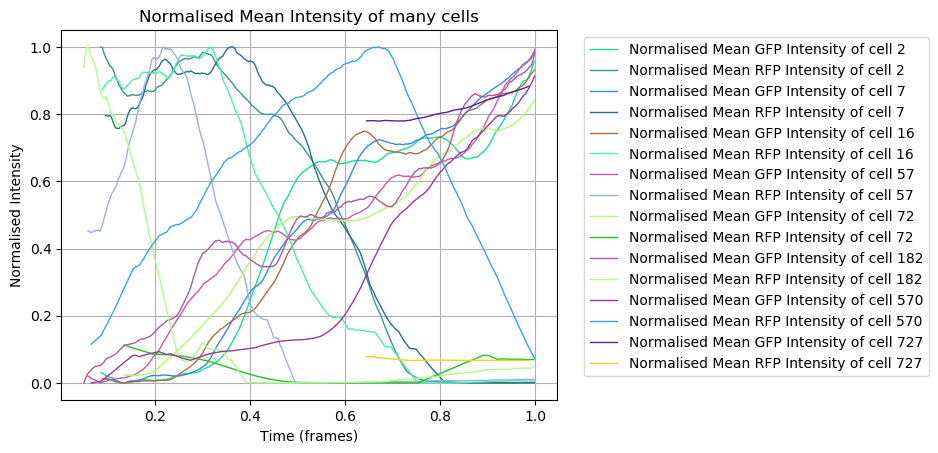

In [220]:
##### mean_window = 50 # number of periods to define rolling mean by
#cell_ids = [72, 57, 16, 46, 182, 239]#,414, 441, 570, 640, 659, 713, 727, 748] #OR 2, 7, 16, 57, 72, 182, 570, 727

print("Input cell IDs")
cell_ids = str_convert(input())
for cell in cell_ids:
    #cell = 46
    ### Load data
    fn = "cell_ID_" + str(cell) + ".csv"
    stat_location = os.path.join(stat_path, fn)
    print(stat_location)
    df = pd.read_csv(stat_location)

    ## collect different intensities to normalise ##
    y_variables = list(df.columns[2:6]) +list(df.columns[9:12])#this calls just the first four variables 
    norm_df = pd.DataFrame([])

    for y in y_variables:
            #intensity = norm_df[y] 
            y_name = 'Normalised ' + y      
            ### pick method of normalisation 
            #norm_intensity = normalisation(norm_df[y]) 
            #norm_intensity = normalization(norm_df[y]) 
            norm_intensity = normal(df[y]) 
            norm_df[y_name] = norm_intensity

    norm_df['Sum FI'] = norm_df['Normalised Mean GFP Intensity'] + norm_df['Normalised Mean RFP Intensity'] #summed fluoresence intensity
    norm_df['delta FI'] = norm_df['Normalised Mean GFP Intensity'] - norm_df['Normalised Mean RFP Intensity'] #difference between fluoresence intensity
    norm_df['GFP:RFP ratio'] = norm_df['Normalised Mean GFP Intensity'] / norm_df['Normalised Mean RFP Intensity'] #ratio between fluoresence intensity

    ### defining the onset of S phase (tS) as when the difference between green and red channels is minimum ###
    tS = (abs(norm_df['delta FI']).idxmin())
    print("t = S-phase looks to be", tS, "frames")
    # ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1
    # tS2 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin())
    # print("t = S-phase v2 looks to be", tS2, "frames")
    # ### defining the onset of S phase when the ratio of GFP:RFP is closest to 1 but also the GFP+RFP value is max ### UNFINISHED, necessary?
    # tS3 = ((abs(norm_df['GFP:RFP ratio'])-1).idxmin() + norm_df['Sum FI']).idxmax()
    # print("t = S-phase v3 looks to be", tS3, "frames")

    ### defining the approx onset of M phase as when the difference between green and red channels is max ###
    tM = norm_df['delta FI'].idxmax()
    print("t = Mitosis looks to be", tM, "frames")
    
    ### creation of FUCCI time column for alignment, t0 = 0, tS = 1, tM = 2
    norm_df["FUCCI time"] = 'NaN'
    norm_df["FUCCI time"][:tM] = arange(0, 1, 1/tM)
    #norm_df["FUCCI time"][tS:tS+1] = 0.5
    #norm_df["FUCCI time"][tM:tM+1] = 1

    columns = ["Normalised Mean GFP Intensity", "Normalised Mean RFP Intensity"]#, "Sum FI", "delta FI"]
    #plotting normalised intensities on same plot
    for column in columns: #index in norm_df.columns indicate variables to plot, input a variable selection option
        colour = cell_colour_picker(cell)
        label = column + " of cell " + str(cell)
        #this conditional statement trims the x variable to be the same length as the y var if it is longer (only a zero index issue really as max length x_var will be 1 more than y_var)
        #print(len(x_time), len(aligned_norm_df[column]), column, ", cell ", cell, ", t0 is ", t0) #troubleshooter
        #plt.plot(x, norm_df[column], linewidth=1, color=colour)#, label = label)#, color=colour)
        rolling_mean = norm_df[column].rolling(window=mean_window).mean()
        #plt.plot(x_time, rolling_mean, linewidth=1, label = label, color=colour)
        #plt.plot(x-(mean_window/2), rolling_mean,  label = label, color=colour, linewidth=1)
        plt.plot(norm_df['FUCCI time'], rolling_mean, label = label, linewidth = 1, color = colour)
        #plt.plot(x_time, norm_df["Normalised Area"], linewidth=0.5, color="gray", label = "Normalised Area" )
    #x_error_range = 6
    #x_tM = [int("{}".format(tM+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
    #x_tS = [int("{}".format(tS+i)) for i in range(-x_error_range,x_error_range)[::2]] ## this range should represent the error in estimation of the mitotic phase!!!!!!!!!!!!!!!!
    #plt.vlines(x_tM, 0, 1, label = "mitosis", colors = '#00A398', linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
    #plt.vlines(x_tS, 0, 1, label = "S phase", colors = "#D00027", linestyle = "dotted")#, ymin, ymax, colors='k', linestyles='solid', label='', *, data=None, **kwargs)
    
plt.grid(which = "both")        
plt.ylabel("Normalised Intensity")
plt.xlabel('Time (frames)')
title = "Normalised Mean Intensity of many cells"
plt.title(title)
#save_title = title + ".png"
#plt.savefig(os.path.join(stat_path, cell_id, save_title), dpi=1000)

plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.style.use('default')

plt.show()

## this is for testing the FUCCI phase column
#norm_df.to_csv("/home/nathan/data/SHARC/fucci/fucci1_171201/stats/test.csv", index = False)

In [100]:
#print(norm_df)
### creation of FUCCI time column for alignment, t0 = 0, tS = 1, tM = 2
norm_df["FUCCI time"] = 0
norm_df["FUCCI time"][0:tM] = arange(0, 1, 1/tM)
norm_df["FUCCI time"][tS:tS+1] = 0.5
norm_df["FUCCI time"][tM:tM+1] = 1
from numpy import arange
#print(tS, tM, len(norm_df))


arange(0, 1, 1/tM)

norm_df.to_csv("/home/nathan/data/SHARC/fucci/fucci1_171201/stats/test.csv", index = False)

/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/home/nathan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


# track concatenator
code probably needs a bit more work - execute with caution!

In [ ]:
df1 = []
df2 = []
df3 = []

print("Input the cell IDs of the split tracks - WARNING: will overwrite both original .csv files with merged .csv")
tracks_2_concat = str_convert(input())

cell_track_fn1 = "cell_ID_" + str(tracks_2_concat[0]) + ".csv"
stat_location1 = os.path.join(stat_path, cell_track_fn1)
print(stat_location1)
df1 = pd.read_csv(stat_location1)
cell_track_fn2 = "cell_ID_" + str(tracks_2_concat[1]) + ".csv"
stat_location2 = os.path.join(stat_path, cell_track_fn2)
print(stat_location2)

df2 = pd.read_csv(stat_location2)
df3 = df1.append(df2, ignore_index=True)
df3.to_csv(stat_location1, index=False) # this overwrites both files with new ones
df3.to_csv(stat_location2, index=False)
print(df1, df2, df3)


# glimpse creator

# many-single-cell norm graph generator and saver

Input cell ID
1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 104, 105, 106, 110, 111, 113, 114, 115, 117, 118, 123, 125, 126, 128, 129, 131, 132, 134, 135, 137, 143, 145, 146, 147, 148, 150, 152, 155, 158, 160, 161, 163, 164, 166, 167, 170, 172, 173, 174, 177, 178, 180, 181, 182, 185, 186, 189, 192, 196, 197, 198, 199, 201, 203, 205, 208, 211, 213, 214, 216, 218, 221, 222, 223, 224, 225, 226, 227, 229, 230, 234, 235, 236, 237, 238, 239, 240, 241, 242, 244, 245, 246, 247, 248, 249, 250, 251, 253, 254, 255, 257, 259, 260, 263, 264, 266, 267, 268, 269, 270, 272, 273, 274, 276, 282, 283, 285, 292, 293, 295, 296, 297, 298, 301, 303, 304, 306, 307, 308, 309, 310, 

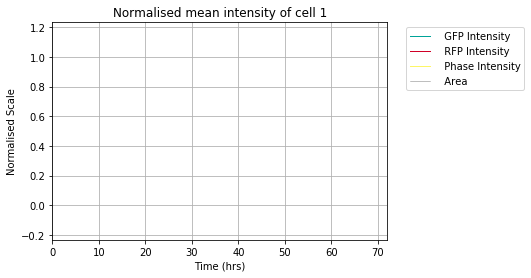

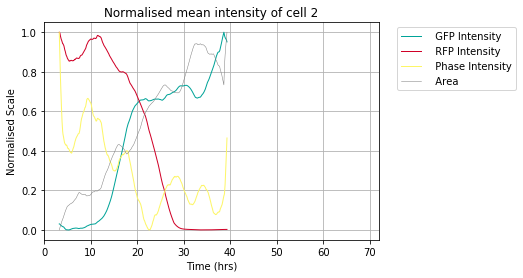

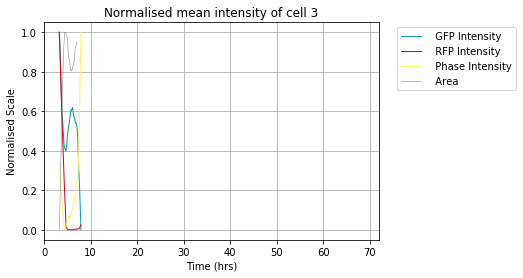

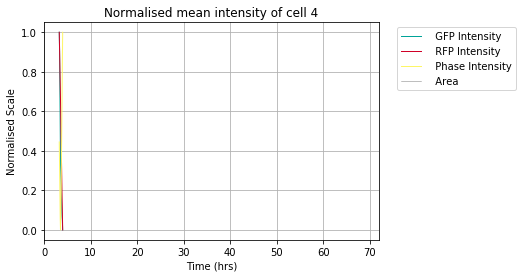

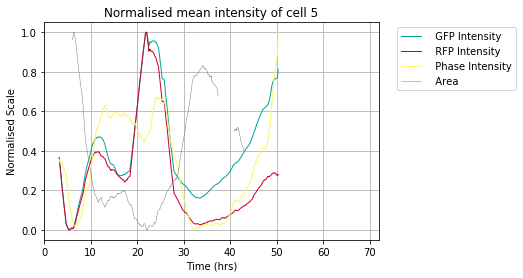

...

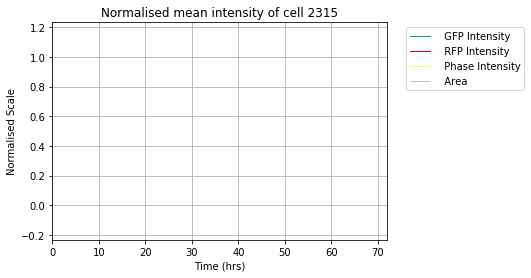

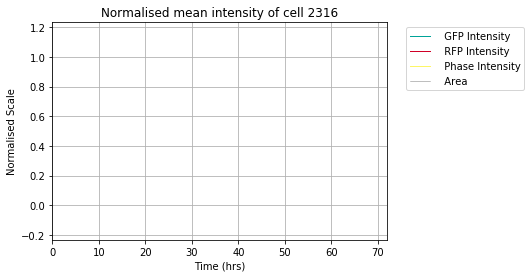

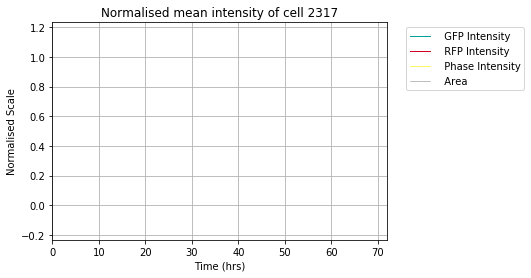

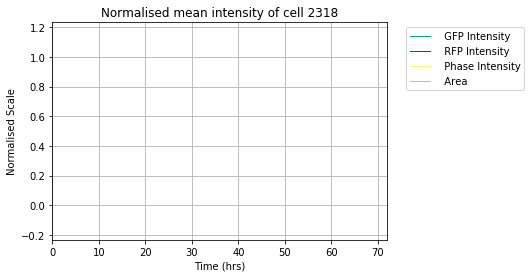

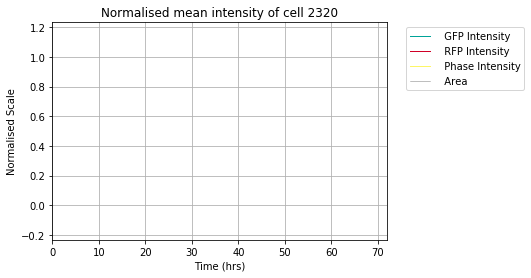

In [125]:
## cell selector
print("Input cell ID")
#gold_exmaples = 2, 7, 16, 57, 72, 182, 570, 727, 
#mid_tier_examples = 28, 43, 164
#other_examples = 5, 20, 239, 260, 330, 441, 503, 640, 659, 713, 748, 817
#all_examples =2, 7, 16, 57, 72, 182, 570, 727, 28, 43, 164, 5, 20, 239, 260, 330, 441, 503, 640, 659, 713, 748, 817
cells=str_convert(input())
for cell in cells:
    stat_path = "/home/nathan/data/SHARC/fucci/fucci1_171201/stats/cellpose_nuclear"
    fn = "cell_ID_" + str(cell) + ".csv"
    stat_location = os.path.join(stat_path, fn)
    df = pd.read_csv(stat_location)
    norm_df = pd.DataFrame([])

    x = df.index
    x_time = df.index * 4/60 #for plotting the x axis as hours assuming time period between frames is 4mins
    y_variables = list(df.columns[2:6]) + list(df.columns[9:12]) #this calls just the first four variables 

    ## collect different variables to normalise
    for y in y_variables:
            y_name = 'Normalised ' + y
            norm_intensity = normal(df[y]) 
            norm_df[y_name] = norm_intensity  
    ## plot different norm variables
    for column in norm_df.columns[4:7]: #index in df.columns indicate variables to plot
        colour = colour_picker(column)
        rolling_mean = norm_df[column].rolling(window=mean_window).mean()
        label = (column.replace('Normalised', '')).replace('Mean', '')
        plt.plot(x_time, rolling_mean, linewidth=1, color=colour, label = label)
        #plt.plot(x_time, norm_df[column], linewidth=0.5, color=colour, label = column)
    plt.plot(x_time, norm_df["Normalised Area"].rolling(window=mean_window).mean(), linewidth=0.5, color="gray", label = "  Area" )
    plt.ylabel("Normalised Scale")
    plt.xlabel('Time (hrs)')
    plt.xlim(0, 72)
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
    plt.grid()
    title = "Normalised mean intensity of cell " + str(cell)
    plt.title(title)
    #plt.figure(figsize=[20,8], dpi=3000)
    save_title = "Cell_ID_"+ cell + ".pdf"
    output_path = 'graphs/single_cell_gfp.rfp.phase.area'
    plt.savefig(os.path.join(stat_path, output_path, save_title), transparent=True, bbox_inches="tight", pad_inches=0.25, dpi = 300)
    plt.show()

# generating lists of cell IDs based on criterion

In [123]:
filename ='/home/nathan/data/SHARC/fucci/fucci1_171201/tracks/tracks_cellpose/cellpose_nuclear.h5'
with btrack.dataio.HDF5FileHandler(filename, 'r') as h:
    tracks = h.tracks
tracks = (tracks[0]) #initially, tracks[0] is the tracks for cell type 0 (ie, WT or Scr etc)
print("Track information loaded")

filtered_tracks = [track for track in tracks ]#if len(track) > 100] #excludes track lengths below x frames
track_lengths = [len(track) for track in filtered_tracks] 
track_IDs = [track.ID for track in filtered_tracks] 
#track_IDs = natsorted(track_IDs)
print("number of tracks that are in this criterion are = ", len(track_IDs))
print(natsorted(track_IDs))
for i in range(len(track_lengths)):
    print("ID = ", track_IDs[i], "/ Length = ", track_lengths[i])

[INFO][2020/08/12 06:41:56 PM] Opening HDF file: /home/nathan/data/SHARC/fucci/fucci1_171201/tracks/tracks_cellpose/cellpose_nuclear.h5
[INFO][2020/08/12 06:41:56 PM] Loading tracks: obj_type_1...
[INFO][2020/08/12 06:41:56 PM] Loading obj_type_1 (160396, 5) (160396 filtered: None)...
[INFO][2020/08/12 06:41:58 PM] Closing HDF file: /home/nathan/data/SHARC/fucci/fucci1_171201/tracks/tracks_cellpose/cellpose_nuclear.h5


Track information loaded
number of tracks that are in this criterion are =  2033
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 109, 110, 111, 112, 113, 114, 115, 117, 118, 121, 123, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 139, 142, 143, 144, 145, 146, 147, 148, 149, 150, 152, 153, 155, 156, 157, 158, 159, 160, 161, 163, 164, 166, 167, 169, 170, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 203, 205, 206, 207, 208, 210, 211, 212, 213, 214, 215, 216, 218, 221, 222, 223, 224, 225, 226, 227, 2

ID =  946 / Length =  300
ID =  947 / Length =  64
ID =  948 / Length =  688
ID =  949 / Length =  3
ID =  950 / Length =  2
ID =  951 / Length =  1
ID =  956 / Length =  1
ID =  955 / Length =  7
ID =  954 / Length =  523
ID =  953 / Length =  1
ID =  952 / Length =  345
ID =  957 / Length =  1
ID =  958 / Length =  8
ID =  959 / Length =  467
ID =  961 / Length =  1
ID =  962 / Length =  1
ID =  963 / Length =  250
ID =  964 / Length =  2
ID =  965 / Length =  7
ID =  966 / Length =  4
ID =  969 / Length =  1
ID =  967 / Length =  1
ID =  968 / Length =  1
ID =  970 / Length =  21
ID =  971 / Length =  676
ID =  972 / Length =  1
ID =  973 / Length =  192
ID =  974 / Length =  194
ID =  975 / Length =  15
ID =  977 / Length =  1
ID =  978 / Length =  30
ID =  980 / Length =  15
ID =  981 / Length =  455
ID =  982 / Length =  1
ID =  984 / Length =  2
ID =  983 / Length =  2
ID =  985 / Length =  1
ID =  986 / Length =  139
ID =  987 / Length =  277
ID =  988 / Length =  4
ID =  989 /

ID =  1873 / Length =  21
ID =  1874 / Length =  242
ID =  1875 / Length =  4
ID =  1876 / Length =  2
ID =  1877 / Length =  1
ID =  1878 / Length =  16
ID =  1879 / Length =  1
ID =  1880 / Length =  2
ID =  1882 / Length =  1
ID =  1886 / Length =  1
ID =  1885 / Length =  1
ID =  1883 / Length =  243
ID =  1884 / Length =  1
ID =  1889 / Length =  3
ID =  1890 / Length =  1
ID =  1891 / Length =  240
ID =  1892 / Length =  1
ID =  1893 / Length =  3
ID =  1894 / Length =  239
ID =  1895 / Length =  1
ID =  1896 / Length =  238
ID =  1897 / Length =  238
ID =  1906 / Length =  1
ID =  1905 / Length =  1
ID =  1903 / Length =  24
ID =  1900 / Length =  237
ID =  1898 / Length =  3
ID =  1902 / Length =  10
ID =  1908 / Length =  1
ID =  1909 / Length =  3
ID =  1910 / Length =  1
ID =  1911 / Length =  9
ID =  1913 / Length =  234
ID =  1914 / Length =  38
ID =  1915 / Length =  2
ID =  1921 / Length =  6
ID =  1920 / Length =  232
ID =  1919 / Length =  5
ID =  1918 / Length =  1
ID